# MLE vs MAP
MLE - maximum likelihood estimator \\
MAP - maximum a posteriori \\

For each scenario, both the MLE and MAP estimates will be found. The MLE only looks at observed data while the MAP looks at observed data and a prior distribution. The prior distribution selected is a conjugate estimator of the true distribution. Theoretically, when a good prior distribution is chosen, even with poor hyperparameters, the posterior (MAP) will eventually converge to have similar or less error than the MLE, even if poor hyperparameters are  selected.



In [219]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation

from scipy import stats
from scipy.stats import beta as beta_dist
from IPython.display import HTML
seed = 314

# Implement conjugate estimators Binomial
- The conjugate estimator for the Binomial Distribution is the Beta Distribution because they are proportional.


In [220]:
def plot_beta_distribution(success,fail,label):
  x = np.linspace(0,1,1000)
  y = beta_dist.pdf(x,success,fail)
  plt.plot(x,y,label=label)

## Exploring Binomial Distribution
The binomial distribution is a pdf displaying the probability of x successes in N trials. \\
The beta distribution is a pdf which models continuous random variables between 0 and 1. We use it here to model the probability of sucess (1) in a binomial distribution which has values of either 0 or 1.

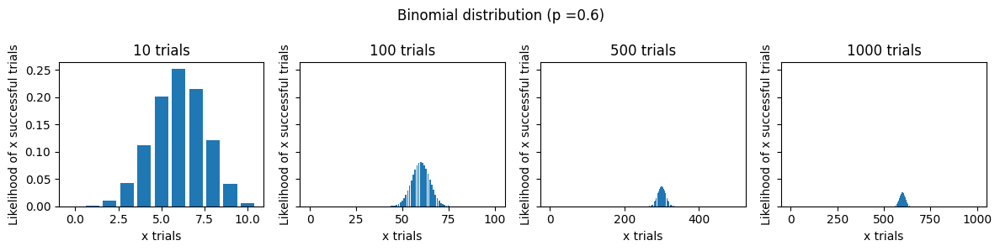

In [221]:
trials_list = [10,100,500,1000]
true_p = 0.6
#different shapes of the binomial distribution as trials increase
fig, axes = plt.subplots(1, len(trials_list), figsize = (3*4, 3), sharey=True)
fig.suptitle(f"Binomial distribution (p ={true_p})")
for ax in axes.flat:
  ax.set(xlabel = 'x trials', ylabel = 'Likelihood of x successful trials')

for i, trial in enumerate(trials_list):
  binom_dist = stats.binom(trial, true_p)
  #probabilities of 1,2,3,.... successes
  probs = binom_dist.pmf(range(0,trial+1))

  x = np.arange(0, trial+1)

  axes[i].bar(x, probs)
  axes[i].set_title(f"{trial} trials")

fig.tight_layout()


## Binomial Maximum Likelihood Estimator (MLE) and MAP

\begin{align}
\mathbf{\mu_{ML}} = \frac{1}{N} \sum_{i=1}^n x_n
\end{align}

MLE = number of successes over the number of trials. For data pulled from the binomial distribution which can be found using the beta distribution

MAP = The same but the successes have the number of successes from the prior and the total number of trials includes the number of trials from the prior

In [222]:
def mse(estimate,true_val):
  true_val_arr = np.full((len(estimate), 1), np.float64(true_val))
  return (np.square(np.array(estimate)-true_val_arr)).mean(axis = 0)


def MLE_Binomial(prior_success, prior_failure, n_trials, true_p):
  #first create data from true gaussian dist
  data = stats.binom.rvs(n = 1, p = true_p, size =n_trials, random_state= seed)

  #MLE estimate starts off at 0 at 0th trial
  mle_estimate_arr = np.array(0)

  #MAP estimates
  posterior_success_arr = np.array(prior_success)
  posterior_failure_arr = np.array(prior_failure)
  prior_estimate = prior_success/(prior_success+prior_failure)
  map_estimate_arr = np.array(prior_estimate)

  num_success = 0
  for i in range(n_trials):
    #get one new piece of data
    new_data = data[i:i+1]

    #update number of successes and failures
    posterior_success = prior_success + new_data
    if new_data == 0:
      posterior_failure = prior_failure + 1
    else:
      num_success = num_success + 1

    posterior_success_arr = np.append(posterior_success_arr, posterior_success)
    posterior_failure_arr = np.append(posterior_failure_arr, posterior_failure)

    #mle estimate
    mle_estimate = num_success/(i+1)
    mle_estimate_arr = np.append(mle_estimate_arr, mle_estimate)

    #map estimate
    map_estimate = posterior_success/(prior_success + prior_failure + 1)
    map_estimate_arr = np.append(map_estimate_arr, map_estimate)

    #update priors
    prior_success = posterior_success
    prior_failure = posterior_failure

  return posterior_success_arr, posterior_failure_arr, mle_estimate_arr, map_estimate_arr

def plot_model_dists(original_success, original_failure, original_map, final_success, final_failure, final_map, final_mle, true_p, n_trials):
  plt.figure(figsize=(10,6))

  #plot original prior beta
  plot_beta_distribution(original_success, original_failure, f"Original Prior")

  #plot final beta
  plot_beta_distribution(final_success, final_failure, f"Final Posterior")

  #plot true_p, mle_estimate, prior_estimate
  plt.axvline(true_p, color = 'r', label = f"True p={true_p}")
  plt.axvline(original_map, color = 'b', linestyle= "--", label = f"Prior Estimate={original_map:.2f}")
  plt.axvline(final_map, color = 'orange', linestyle= "--", label = f"MAP={final_map:.2f}")
  plt.axvline(final_mle, color = 'g', linestyle= "--", label = f"MLE={final_mle:.2f}")

  plt.title(f"Beta Dist (a={original_success}, b={original_failure}, n_trials = {n_trials})")
  plt.xlabel('Probability of Success')
  plt.ylabel('Density')
  plt.legend()
  plt.show()

def plot_mses(mle_list, map_list, true_p, n_trials, prior_success, prior_failure):

  #calculate mse
  mles_mses = mse(mle_list, true_p)
  maps_mses = mse(map_list, true_p)

  plt.figure(figsize=(10,6))

  x = np.arange(0,n_trials+1).reshape((n_trials+1, 1)) #this has 0 to n_trials inclusive
  plt.plot(x, mles_mses, label = "MLE MSE")

  plt.plot(x.flatten(), maps_mses.flatten(), label = "MAP MSE")

  plt.xlabel("Trial Number")
  plt.ylabel("MSE")
  plt.title(f"MSEs of Prior (MAP) and ML Estimates (a={prior_success}, b={prior_failure})")
  plt.legend()

  plt.show()

def plot_multiple_pdfs(posterior_ss, posterior_fails, maps, true_p, n_trials):
  trial_numbers = np.arange(0, n_trials+1, (n_trials+1)//10)
  plt.figure(figsize=(10,6))
  for trial_number in trial_numbers:
    success = posterior_ss[trial_number]
    fail = posterior_fails[trial_number]
    plot_beta_distribution(success, fail, f"Trial:{trial_number} (Mean:{maps[trial_number]:.2f})")

  plt.axvline(true_p, color = 'r', label = f"True p={true_p}")
  plt.legend()
  plt.title(f"Posterior at Various Trials (a={posterior_ss[0]}, b={posterior_fails[0]})")
  plt.xlabel("Probability of success")
  plt.ylabel("Density")
  plt.show()



### Beta Dist: a = 1, b=1 uniform, Mean = 0.5

In [223]:
true_p_binomial = 0.6

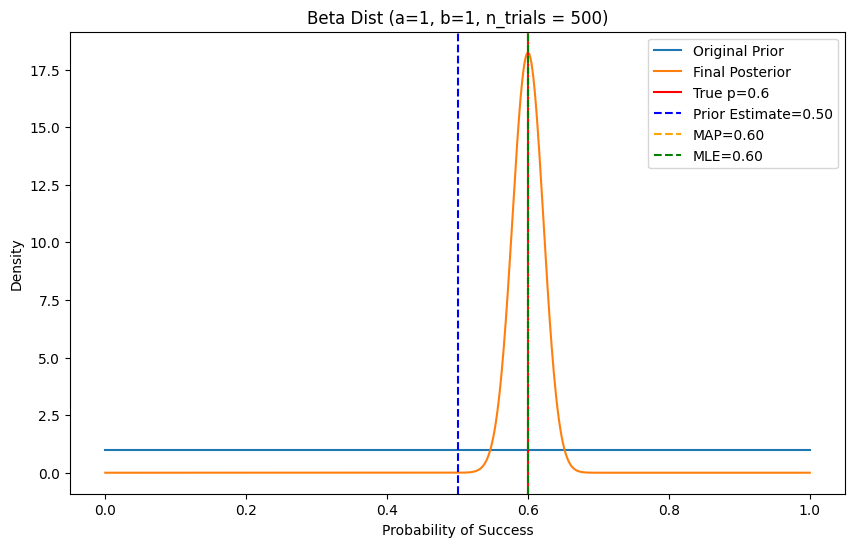

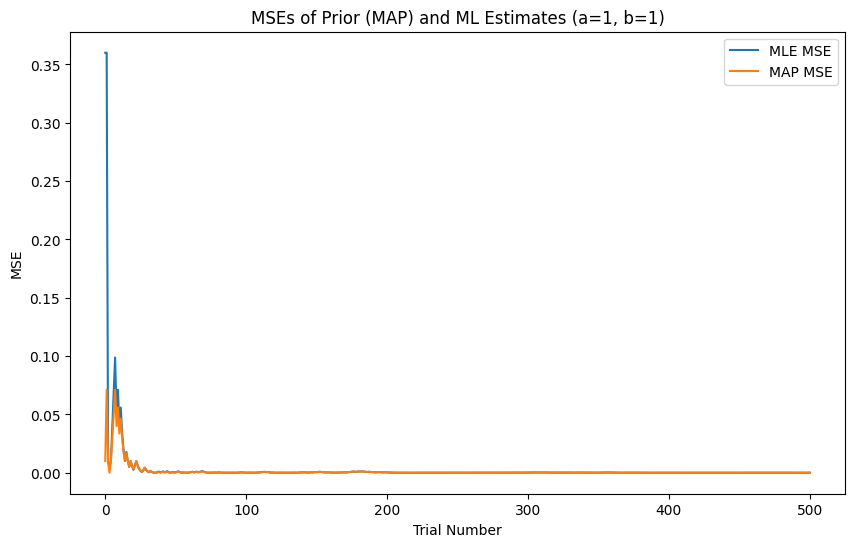

In [224]:
n_trials = 500
prior_success_1 = 1
prior_failure_1 = 1
posterior_ss_1, posterior_fails_1, mles_binomial_1, maps_binomial_1 = MLE_Binomial(prior_success_1, prior_failure_1, n_trials, true_p)
plot_model_dists(posterior_ss_1[0], posterior_fails_1[0], maps_binomial_1[0], posterior_ss_1[-1], posterior_fails_1[-1], maps_binomial_1[-1], mles_binomial_1[-1],true_p, n_trials)
plot_mses(mles_binomial_1, maps_binomial_1, true_p, n_trials, prior_success_1, prior_failure_1)

### Beta Dist: a = 30, b=70, left-skewed, Mean = 0.3

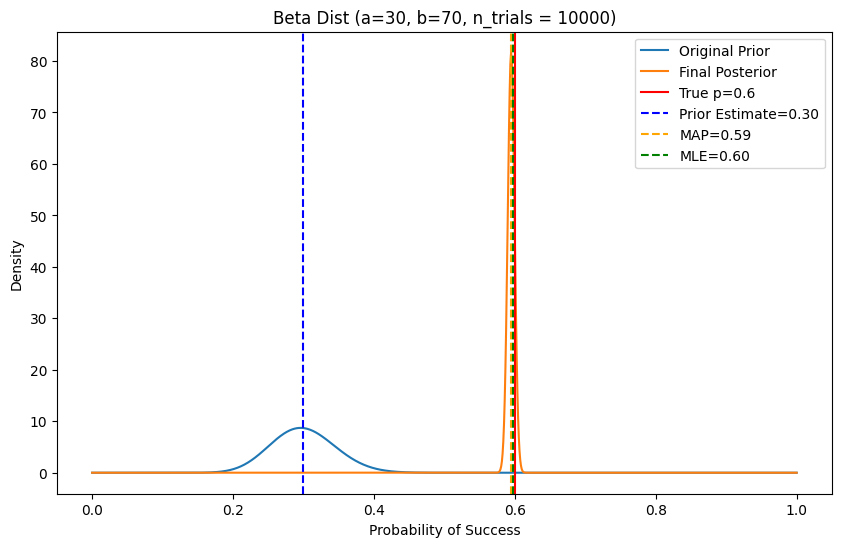

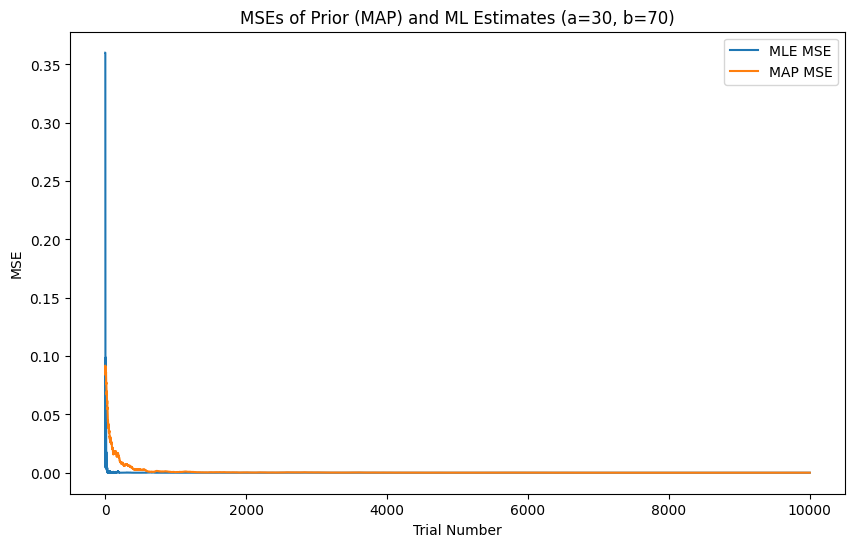

In [225]:
n_trials = 10000
prior_success_2 = 30
prior_failure_2 = 70
posterior_ss_2, posterior_fails_2, mles_binomial_2, maps_binomial_2 = MLE_Binomial(prior_success_2, prior_failure_2, n_trials, true_p)
plot_model_dists(posterior_ss_2[0], posterior_fails_2[0], maps_binomial_2[0], posterior_ss_2[-1], posterior_fails_2[-1], maps_binomial_2[-1], mles_binomial_2[-1],true_p, n_trials)
plot_mses(mles_binomial_2, maps_binomial_2, true_p, n_trials, prior_success_2, prior_failure_2)

### Beta Dist: a=70, b=30, right-skewed, Mean = 0.7

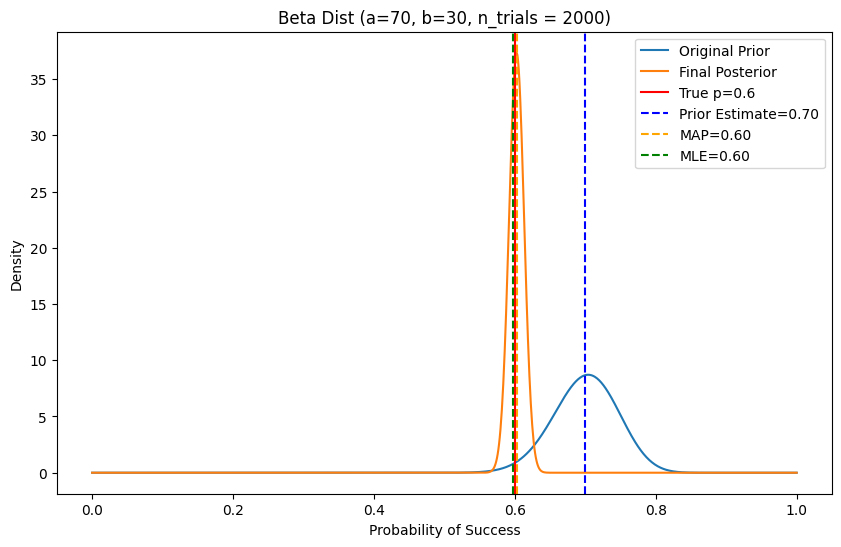

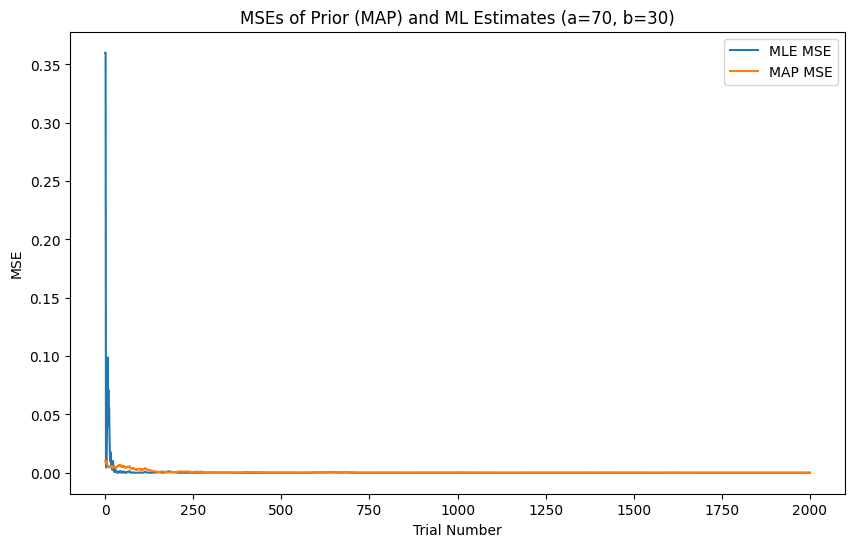

In [226]:
n_trials = 2000
prior_success_3= 70
prior_failure_3= 30
posterior_ss_3, posterior_fails_3, mles_binomial_3, maps_binomial_3 = MLE_Binomial(prior_success_3, prior_failure_3, n_trials, true_p)
plot_model_dists(posterior_ss_3[0], posterior_fails_3[0], maps_binomial_3[0], posterior_ss_3[-1], posterior_fails_3[-1], maps_binomial_3[-1], mles_binomial_3[-1],true_p, n_trials)
plot_mses(mles_binomial_3, maps_binomial_3, true_p, n_trials, prior_success_3, prior_failure_3)

### Multiple PDFs for Beta Dist: a=70, b=30, right-skewed, Mean = 0.7

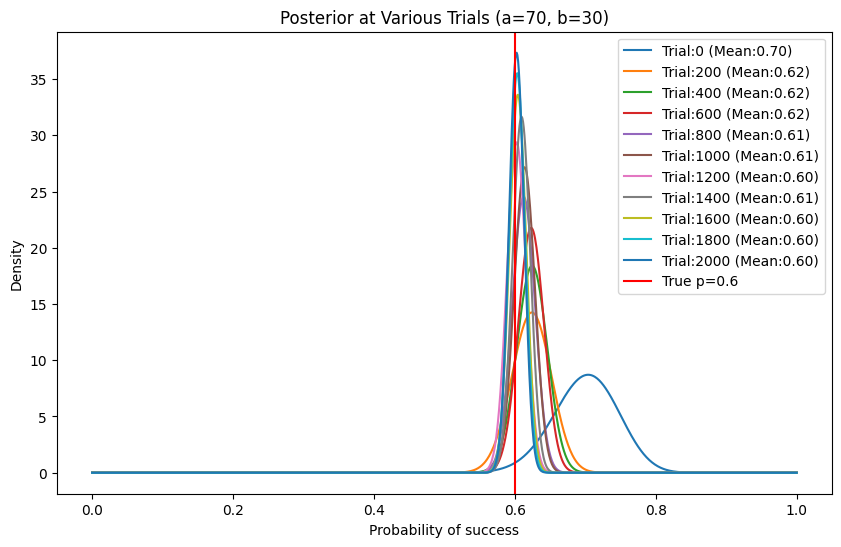

In [227]:
plot_multiple_pdfs(posterior_ss_3, posterior_fails_3, maps_binomial_3, true_p_binomial, n_trials)

As trials increase, the MAP estimate for the mean gets closer to the true mean of the binomial distribution. \\
While enough trials eventually outweigh a bad prior (like in the case of a=30, b=40, left skewed) it takes significantly more trials than the ML estimate to converge. We can see in that aforementioned case, after 10,000 trials, the MAP (0.59) is still worse than the ML estimate (0.60). Granted, the hyperparams chosen for the beta distribution here seem quite ludricrious as it essentially assumes that 100 trials have occurred prior which have a success rate egregiously different from the true success rate. It's probably recommended to keep the original prior success and failure for the beta distribution relatively low.  

# Gaussian Estimator with Known Variance

Conjugate prior for gaussian dist is the gaussian dist itself \\

Hyperparams for gaussian dist are the mean, μ,  and the variance, σ² \\

Here we know the variance, σ² already **but we still update it because it influences the estimation of the mean** \\

MLE when variance is known is sample μ (only dependant on data seen) \\
Bayesian approach should take into account the prior knowledge we have

**MLE** = for mean, μ, it is the sample mean of data we have seen.

**MAP** = for mean, it is basically a weighted average of the prior_mean and the ML mean.


$$f(\mu) = \frac{1}{\sqrt{2\pi(\sigma^2/n)}} \exp\left(-\frac{(\mu - \bar{x})^2}{2(\sigma^2/n)}\right)$$

In [228]:
def plot_gaussian(x, mean, std):
  gaussian = np.exp(-0.5*(x-mean)**2 / std**2) /(std*np.sqrt(2*np.pi))
  return gaussian

def gaussian_conj_prior(prior_mean, prior_var, n_trials, true_mean, true_var):
  #first create data from true gaussian dist
  data = stats.norm.rvs(loc=true_mean, scale = np.sqrt(true_var), size=n_trials, random_state=seed)

  #MLE estimate starts off at 0 bc 0 is sample mean
  mles = np.array(0)

  #MAPs
  post_means = np.array(prior_mean)
  post_vars = np.array(prior_var)

  for i in range(n_trials):
    observed_data = data[0:i+1]

    #MLE = sample mean
    mle = np.mean(observed_data)

    #Bishop 2.141
    post_mean = (true_var*prior_mean)/((i+1)*prior_var +true_var) + ((i+1)*prior_var*mle)/((i+1)*prior_var +true_var)
    #Bishop 2.142
    post_var = ((1/prior_var) +(i+1)/true_var)**-1

    post_means = np.append(post_means, post_mean)
    post_vars = np.append(post_vars, post_var)
    mles = np.append(mles, mle)

    #update priors
    prior_mean = post_mean
    prior_var = post_var

  return post_means, post_vars, mles


def gauss_plot_mle_map(post_means, post_vars, mles, true_mean, true_var, n_trials):
  #Plotting
  fig, axes = plt.subplots(1, 2, figsize = (20, 6))
  fig.suptitle(f"Gaussian with Known σ²")

  x = np.linspace(true_mean - (2*true_var),true_mean+(2*true_var),5000)
  posterior_x = np.linspace(true_mean-.5, true_mean+0.5,5000)
  prior = plot_gaussian(x, post_means[0], np.sqrt(post_vars[0]))
  posterior = plot_gaussian(x, post_means[-1], np.sqrt(true_var))
  true = plot_gaussian(x, true_mean, np.sqrt(true_var))

  axes[0].set_title(f"Gaussian Conjugate Estimator (μ:{int(post_means[0])}, σ²:{int(post_vars[0])}, n_samples: {n_trials})")
  axes[0].plot(x,prior, color = "b", label = "Prior")
  axes[0].plot(x,posterior, color = "orange", label = "Posterior")
  axes[0].plot(x, true, color= "r", label = "True Gaussian")
  axes[0].axvline(true_mean, color = 'r', linestyle = "--", label = f"True μ: {true_mean}")
  axes[0].axvline(mles[-1], color = 'g', linestyle = "--", label = f"MLE: {mles[-1]:.2f}")
  axes[0].axvline(post_means[-1], color = "orange", linestyle = "--", label = f"Posterior μ: {post_means[-1]:.2f}")
  axes[0].legend()
  axes[0].set(xlabel ="μ", ylabel = "Density")

  #this is with post var, moreso shows uncertainty in the post mean. Not dist we are trying to recreate
  posterior_pdf = plot_gaussian(posterior_x, post_means[-1], np.sqrt(post_vars[-1]))

  axes[1].set_title(f"Posterior μ")
  axes[1].plot(posterior_x,posterior_pdf, color = "orange", label = f"Posterior μ: = {post_means[-1]:.2f}")
  axes[1].axvline(post_means[-1], color = 'orange', linestyle = "--")
  axes[1].axvline(true_mean, color = 'r', linestyle = "--", label = f"True μ: {true_mean}")
  axes[1].axvline(mles[-1], color = 'g', linestyle = "--", label = f"MLE: {mles[-1]:.2f}")
  axes[1].legend()
  axes[1].set(xlabel ="μ", ylabel = "Density")

  fig.tight_layout()

def gauss_plot_mses(mles, post_means, true_mean, n_trials,):

  #calculate mse
  mles_mses = mse(mles, true_mean)
  maps_mses = mse(post_means, true_mean)

  plt.figure(figsize=(10,6))

  x = np.arange(0,n_trials+1).reshape((n_trials+1, 1)) #this has 0 to n_trials inclusive
  plt.plot(x, mles_mses, label = "MLE MSE")

  plt.plot(x.flatten(), maps_mses.flatten(), label = "MAP MSE")

  plt.xlabel("Trial Number")
  plt.ylabel("MSE")
  plt.title(f"MSEs of Maximum a posteriori and ML Estimates (μ:{int(post_means[0])}, σ²:{int(post_vars[0])})")
  plt.legend()
  plt.axis([0,n_trials, 0, 1])

  plt.show()

def gauss_plot_multiple_pdfs(post_means, post_vars, true_mean, true_std, n_trials):
  trial_numbers = np.arange(0, n_trials+1, (n_trials+1)//10)
  x = np.linspace((-true_mean*true_std),(true_mean*true_std)+1,5000)
  plt.figure(figsize=(10,6))

  for trial_number in trial_numbers:
    mean = post_means[trial_number]
    gaussian = plot_gaussian(x,mean, true_std)
    plt.plot(x, gaussian, label= f"Trial:{trial_number} (Mean:{mean:.2f})")

  #plot true gaussian
  gaussian = plot_gaussian(x, true_mean, true_std)
  plt.plot(x, gaussian, color = 'r', label = "True Gaussian")
  plt.axvline(true_mean, color = 'r', linestyle = "--")

  plt.legend()
  plt.title(f"Posterior at Various Trials (μ={post_means[0]}, σ²={post_vars[0]})")
  plt.xlabel("Probability of Success")
  plt.ylabel("Density")
  plt.show()


In [229]:
#true params and sample data
true_mean = 5
true_std = 2
true_var = 4 #this is known

### Gaussian Prior mean = 0, std = 1, var = 1

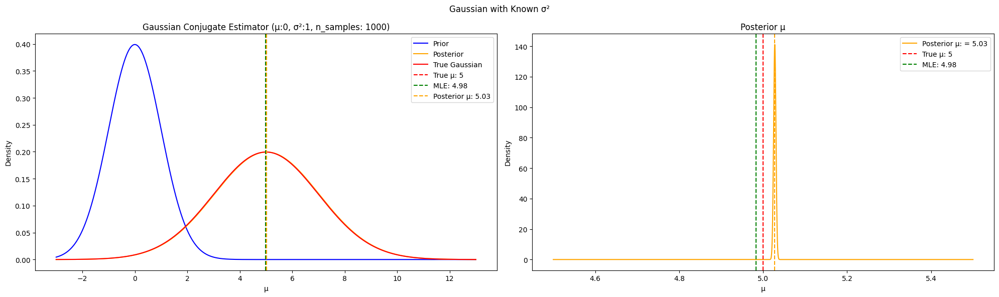

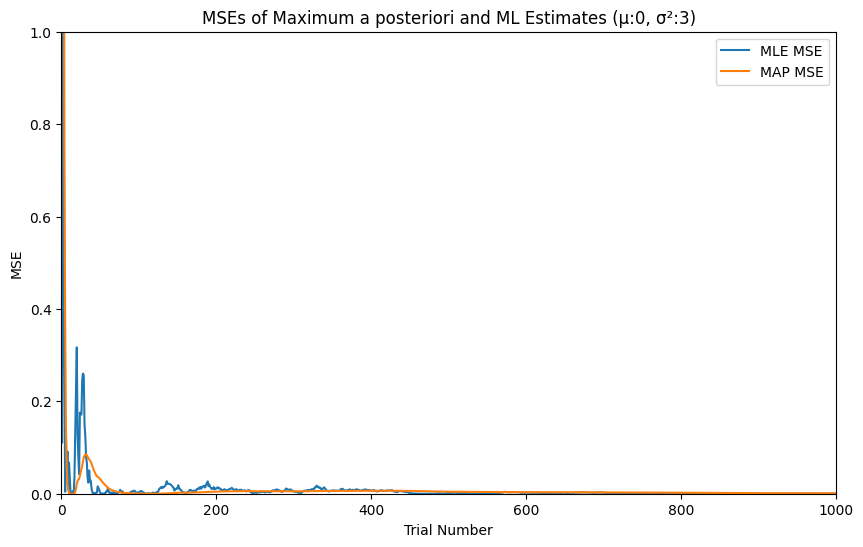

In [230]:
n_trials = 1000
prior_mean_1 = 0
prior_var_1 = 1

post_means_1, post_vars_1, mles_gauss_1 = gaussian_conj_prior(prior_mean = prior_mean_1, prior_var = prior_var_1, n_trials=n_trials, true_mean=true_mean,true_var=true_var)
gauss_plot_mle_map(post_means_1, post_vars_1, mles_gauss_1, true_mean, true_var, n_trials)
gauss_plot_mses(mles_gauss_1, post_means_1, true_mean, n_trials)

The top left plot shows the posterior estimate for the true distribution, it is a gaussian with: \\

*   mean = posterior mean
*   var = true var

The top right plot shows the uncertainty on the posterior mean (i think) it is very skinny because the posterior_var is very low after x trials. It has: \\
*   mean = posterior mean
*   var = posterior var



### Gaussian Prior mean = 7, var = 3

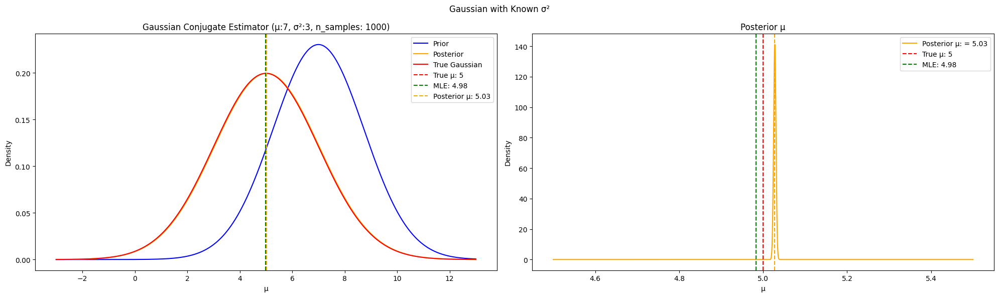

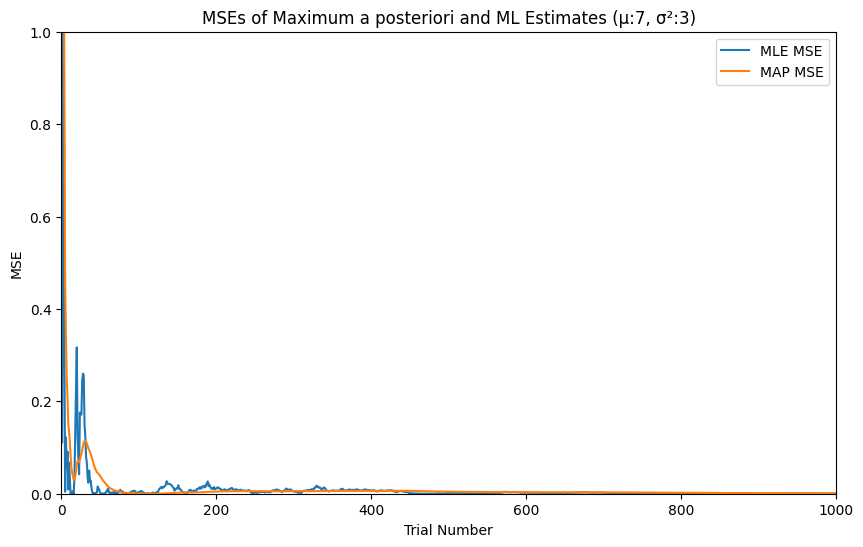

In [231]:
n_trials = 1000
prior_mean_2 = 7
prior_var_2 = 3

post_means_2, post_vars_2, mles_gauss_2 = gaussian_conj_prior(prior_mean = prior_mean_2, prior_var = prior_var_2, n_trials=n_trials, true_mean=true_mean,true_var=true_var)
gauss_plot_mle_map(post_means_2, post_vars_2, mles_gauss_2, true_mean, true_var, n_trials)
gauss_plot_mses(mles_gauss_2, post_means_2, true_mean, n_trials)

### Gaussian Prior mean = 2, var = 5

Note I specifically chose 100 trials here because thats where the MAP had rapid convergence

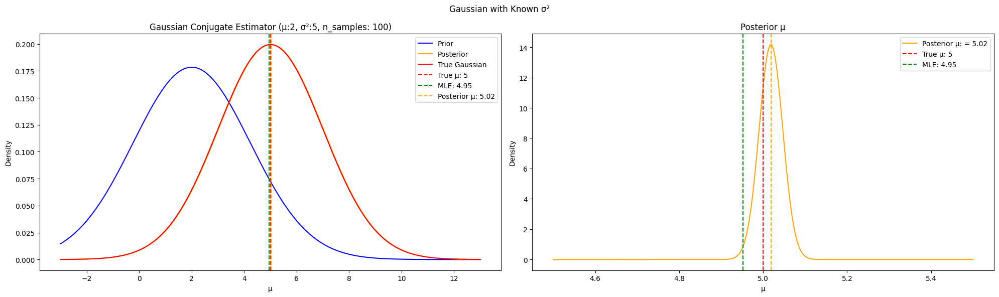

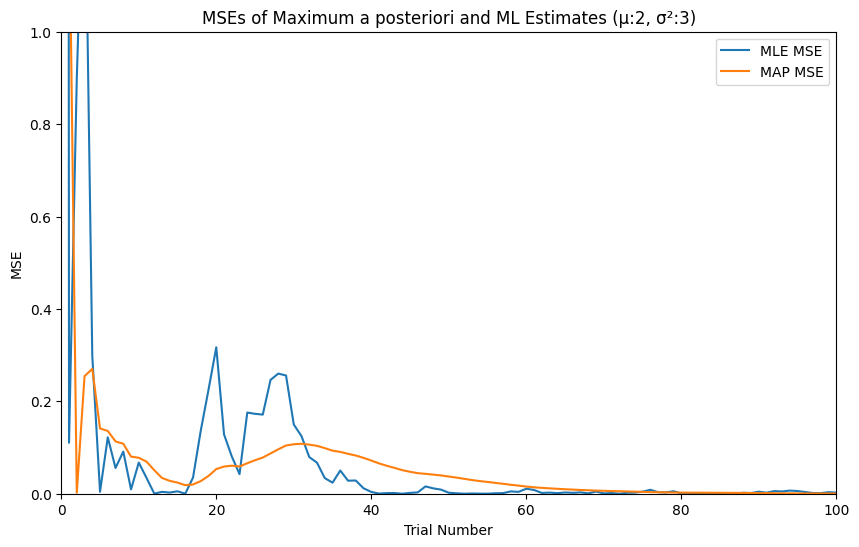

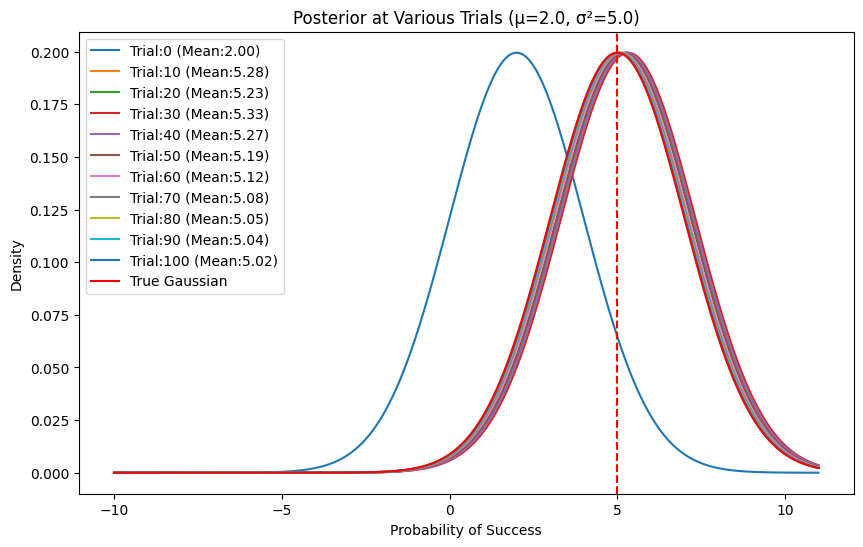

In [232]:
n_trials = 100
prior_mean_3 = 2
prior_var_3 = 5

post_means_3, post_vars_3, mles_gauss_3 = gaussian_conj_prior(prior_mean = prior_mean_3, prior_var = prior_var_3, n_trials=n_trials, true_mean=true_mean,true_var=true_var)

gauss_plot_mle_map(post_means_3, post_vars_3, mles_gauss_3, true_mean, true_var, n_trials)
gauss_plot_mses(mles_gauss_3, post_means_3, true_mean, n_trials)
gauss_plot_multiple_pdfs(post_means_3, post_vars_3, true_mean, true_std, n_trials)

We see in the MSE plots, that there are stretches of earlier trials where the bayesian approach has a lower MSE than that of the MLE. It is evident that the bayesian approach can be a better choice given a smaller amount of data and a good conjugate prior

# Gaussian Estimator with Known Mean

To estimate σ², it is easier to use 1/σ² or λ. When expressing likelihood in terms of λ we find that it is proportional to the gamma distribution. \\ Thus the conj estimator here is the gamma distribution \\

Hyperparams for gamma dist are a and b. These are then used to find the most probable λ of the posterior dist\\


**MLE** = precision of sample data (1/σ²)

**MAP** = most probable λ of the posterior gamma dist

## Gamma distribution exploration

The gamma distribution describes systems and the sequences of events and shocks that lead to failure \\
a - shape param, describes # of shocks till failure, influences spread and skewness of distribution \\

*   a < 1, f(0) = ∞ (no mode)
*   a = 1, f(0) = b (reduces to exp dist with fail rate b)
*   a > 1, f(0) = 0 (more like normal distribution)

b - scale param, describes # of shocks till failure \\



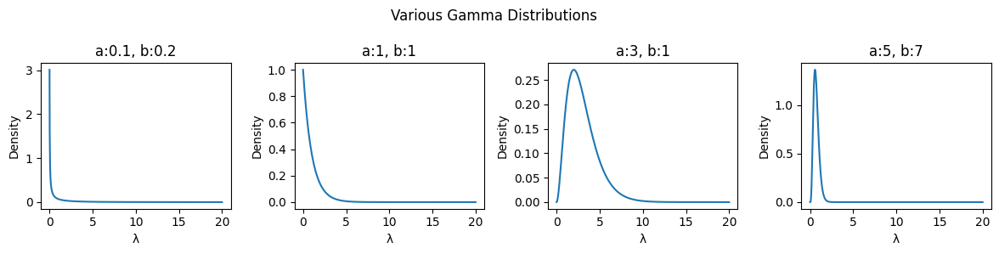

In [233]:
gamma_dist_vals = [(0.1,0.2), (1, 1), (3,1), (5, 7)]

#different shapes of the gamma dist with different values for a and b
fig, axes = plt.subplots(1, len(gamma_dist_vals), figsize = (3*(len(gamma_dist_vals)), 3))
fig.suptitle(f"Various Gamma Distributions")
for ax in axes.flat:
  ax.set(xlabel = 'λ', ylabel = 'Density')

x = np.linspace(0,20, 1000)
for i, vals in enumerate(gamma_dist_vals):
  gamma_dist = stats.gamma.pdf(x, vals[0], loc = 0, scale = 1/vals[1])
  axes[i].plot(x, gamma_dist)
  axes[i].set_title(f"a:{vals[0]}, b:{vals[1]}")

fig.tight_layout()

In [234]:
def gaussian_conj_prior_var(prior_a, prior_b, n_trials, true_mean, true_var):
  #first get data from true gaussian dist
  data = stats.norm.rvs(loc=true_mean, scale = np.sqrt(true_var), size=n_trials, random_state=seed)

  x = np.linspace(true_mean - (2*true_var),true_mean+(2*true_var),10000)

  #MLE estimate starts off at 0 bc 0 is sample var currently
  mles = np.array(0)

  #MAPs
  post_as = np.array(prior_a)
  post_bs = np.array(prior_b)

  #map is the most probable precision
  map = (prior_a - 1)/prior_b #mode of gamma dist
  maps = np.array(map)
  vars = [1/map] #keep track of variance as well


  for i in range(n_trials):
    observed_data = data[0:i+1]

    #mle = sample precision
    mle = 1/(np.var(observed_data)+1e-30) #add small # to get rid of divide by 0

    post_a = prior_a + (i+1)/2 #Bishop 2.150
    post_b = prior_b + (i+1)*0.5*(1/mle) #Bishop 2.151

    map = (post_a-1)/post_b #mode of gamma dist is the most probable precision

    post_as = np.append(post_as, post_a)
    post_bs = np.append(post_bs, post_b)
    mles = np.append(mles, mle)
    maps = np.append(maps, map)
    vars = np.append(vars, 1/map)

    #update priors
    prior_a = post_a
    prior_b = post_b

  return post_as, post_bs, mles, maps, vars

def gauss_var_plot_mle_map(post_as, post_bs, mles, maps, vars, true_mean, true_var, true_pres, n_trials):
  #Plotting
  x = np.linspace(true_mean - (2*true_var),true_mean+(2*true_var),5000)
  pres_x = ((1/true_var)-1,(1/true_var)-1, 5000)

  prior_gauss = plot_gaussian(x, true_mean, np.sqrt(vars[0]))
  posterior_gauss = plot_gaussian(x, true_mean, np.sqrt(vars[-1]))
  true = plot_gaussian(x, true_mean, np.sqrt(true_var))

  fig, axes = plt.subplots(1, 2, figsize = (20, 6))
  fig.suptitle(f"Gaussian with Known μ")
  axes[0].set_title(f"Gaussian Estimate (a:{(post_as[0])}, b:{int(post_bs[0])}, n_samples: {n_trials})")
  axes[0].plot(x,prior_gauss, color = "b", label = f"Prior σ²: {vars[0]:.2f}")
  axes[0].plot(x,posterior_gauss, color = "orange", label = f"Posterior σ²:{vars[-1]:.2f}")
  axes[0].plot(x,true, color = "r", label = f"True Gaussian (σ²: {true_var})")
  axes[0].set_xlabel("x")
  axes[0].set_ylabel("Density")
  axes[0].legend()

  prior = stats.gamma.pdf(x, a=post_as[0], loc = 0, scale = 1/post_bs[0])
  posterior = stats.gamma.pdf(x, a=post_as[-1], loc = 0, scale = 1/post_bs[-1])
  axes[1].set_title(f"Gamma Dist λ (a:{(post_as[0])}, b:{int(post_bs[0])}, n_samples: {n_trials})")
  axes[1].plot(x,prior, color = "b", label = f"Prior (λ: {maps[0]:.2f} )")
  axes[1].plot(x,posterior, color = "orange", label = f"Posterior (λ:{maps[-1]:.2f})")
  axes[1].axvline(true_pres, color = "r", linestyle = "--", label=f"True λ: {true_pres:.2f}")
  axes[1].axvline(mles[-1], color = "g", linestyle = "--", label=f"MLE λ: {mles[-1]:.2f}")
  axes[1].set_xlabel("λ")
  axes[1].set(xlim = [0,0.5], ylim = [0, 1.2*(np.max(posterior))])
  axes[1].set_ylabel("Density")
  axes[1].legend()

  fig.tight_layout()

def gauss_plot_mses(mles, post_vars, true_var, n_trials):

  #calculate mse
  mles_mses = mse((1/(mles+1e-30)), true_var)
  maps_mses = mse(post_vars, true_var)

  plt.figure(figsize=(10,6))

  x = np.arange(0,n_trials+1).reshape((n_trials+1, 1)) #this has 0 to n_trials inclusive
  plt.plot(x, mles_mses, label = "MLE MSE")

  plt.plot(x.flatten(), maps_mses.flatten(), label = "MAP MSE")

  plt.xlabel("Trial Number")
  plt.ylabel("MSE")
  plt.title(f"MSEs of σ² MAP and ML Estimate (a:{(post_as[0])}, b:{int(post_bs[0])})")
  plt.legend()
  plt.axis([0,n_trials, 0, 1])

  plt.show()

def gamma_plot_multiple_pdfs(post_as, post_bs, maps, true_pres, mles,n_trials):
  trial_numbers = np.arange(0, n_trials+1, (n_trials+1)//4)
  #different shapes of the gamma dist with different values for a and b
  fig, axes = plt.subplots(1, len(trial_numbers), figsize = (3*(len(trial_numbers)),3))
  fig.suptitle(f"Posterior Gamma Dist at Different Trials")
  fig.supylabel("Density")
  for ax in axes.flat:
    ax.set(xlabel = 'λ')

  x = np.linspace(true_pres - 1,true_pres+1,5000)
  for i, trial_number in enumerate(trial_numbers):
    gamma_dist = stats.gamma.pdf(x, a = post_as[trial_number], loc = 0, scale = 1/post_bs[trial_number])
    axes[i].plot(x, gamma_dist, color = "orange", label = f"Post λ:{maps[trial_number]}")
    axes[i].axvline(true_pres, color = "red", linestyle="--", label = f"True λ:{true_pres}")
    axes[i].axvline(mles[trial_number], color = "g", linestyle="--", label = f"MLE λ:{mles[trial_number]}")
    axes[i].set_title(f"a:{post_as[trial_number]:.1e}, b:{post_bs[trial_number]:.1e}, trial:{trial_number}")
    axes[i].set_xlim([0.2, 0.3])

  fig.tight_layout()


In [235]:
#true params and sample data
true_mean = 5
true_std = 2
true_var = true_std**2 #this is known
true_pres = 1/true_var

### Gamma Prior a = 0, b = 1

### Gamma Prior a = 0.1, b = 5

<ipython-input-234-bc1138e124dc>:48: RuntimeWarning: invalid value encountered in sqrt
  prior_gauss = plot_gaussian(x, true_mean, np.sqrt(vars[0]))


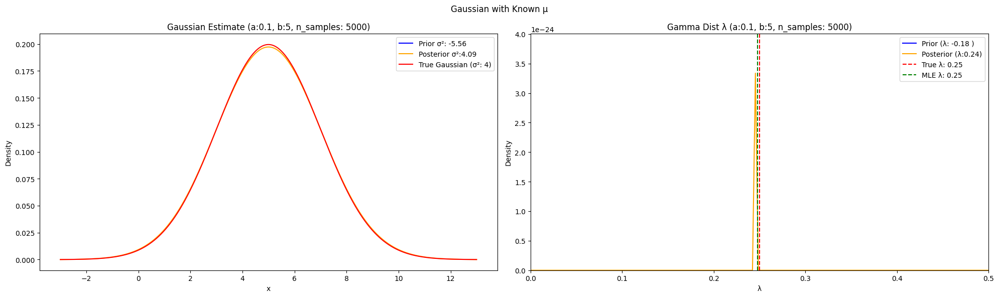

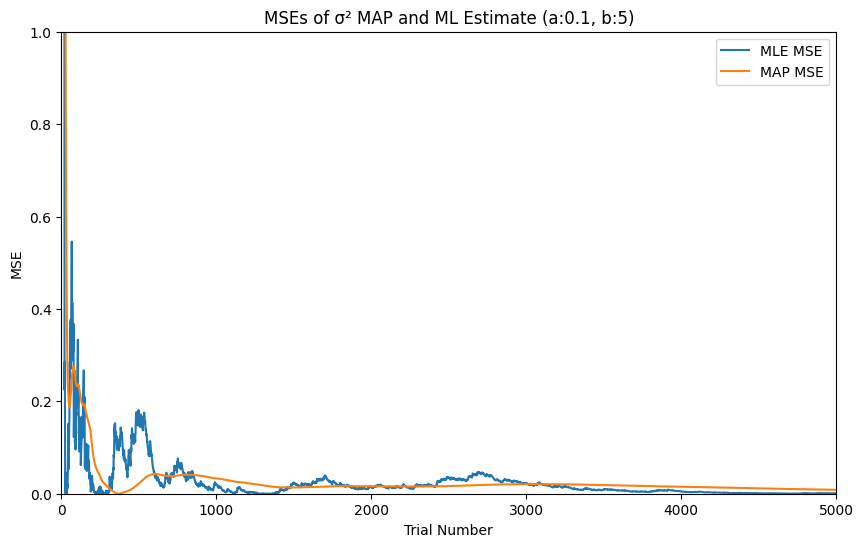

In [236]:
n_trials = 5000
prior_a_2 = 0.1
prior_b_2 = 5

post_as_2, post_bs_2, mles_gamma_2, maps_gamma_2, vars_gamma_2= gaussian_conj_prior_var(prior_a_2, prior_b_2, n_trials, true_mean, true_var)
gauss_var_plot_mle_map(post_as_2, post_bs_2, mles_gamma_2, maps_gamma_2, vars_gamma_2, true_mean, true_var, true_pres, n_trials)
gauss_plot_mses(mles_gamma_2, vars_gamma_2, true_var, n_trials)

### Gamma Prior a = 3, b = 2

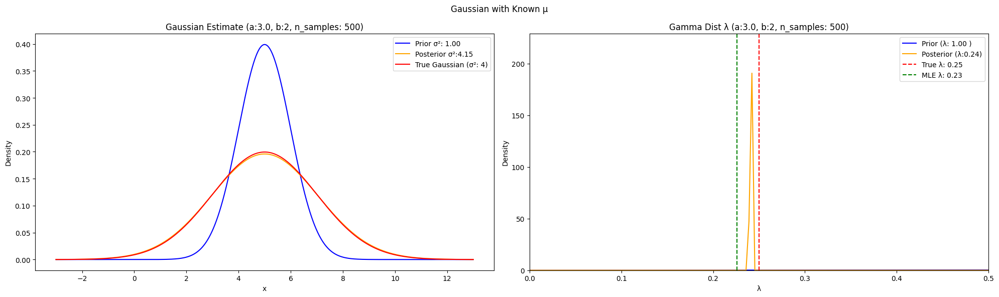

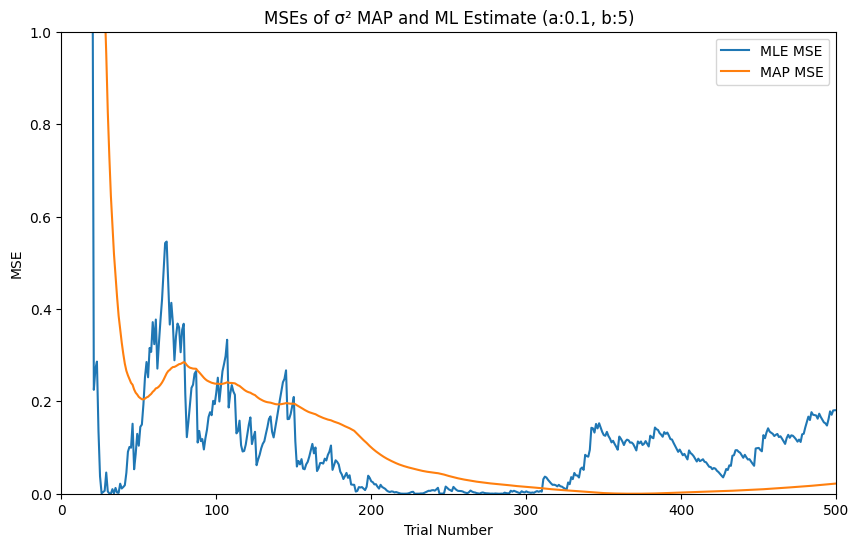

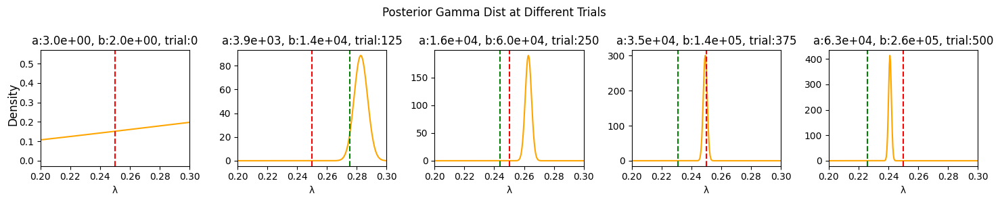

In [237]:
n_trials = 500
prior_a_3 = 3
prior_b_3 = 2

post_as_3, post_bs_3, mles_gamma_3, maps_gamma_3, vars= gaussian_conj_prior_var(prior_a_3, prior_b_3, n_trials, true_mean, true_var)
gauss_var_plot_mle_map(post_as_3, post_bs_3, mles_gamma_3, maps_gamma_3, vars, true_mean, true_var, true_pres, n_trials)
gauss_plot_mses(mles_gamma_3, vars, true_var, n_trials)
gamma_plot_multiple_pdfs(post_as_3, post_bs_3, maps_gamma_3, true_pres, mles_gamma_3, n_trials)

As we can see, around trial 2500, the MAP is a better estimate than the MLE for λ. Looking back, it probably would have been better to use the inverse gamma distribution, instead of doing a lot of reciprocals.

<ipython-input-234-bc1138e124dc>:48: RuntimeWarning: invalid value encountered in sqrt
  prior_gauss = plot_gaussian(x, true_mean, np.sqrt(vars[0]))


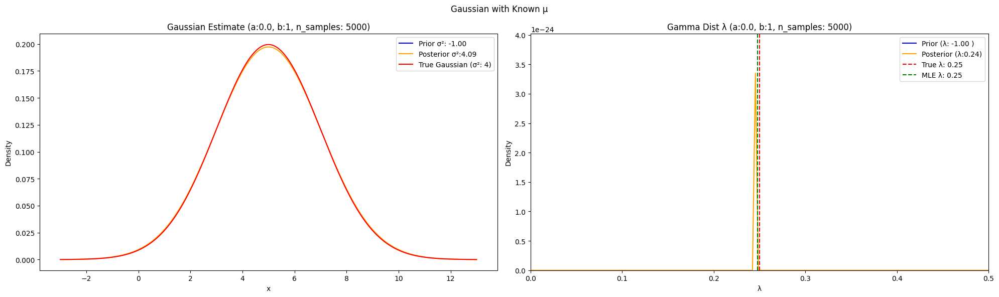

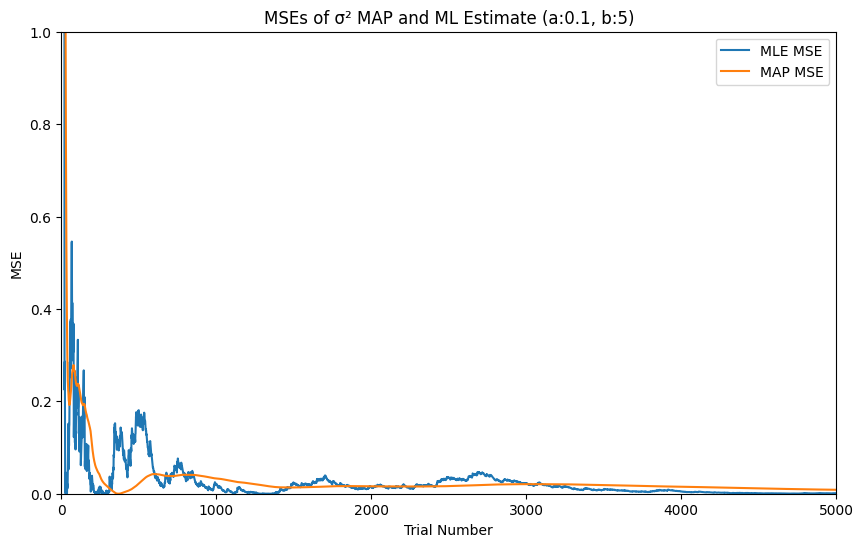

In [238]:
n_trials = 5000
prior_a_1 = 0
prior_b_1 = 1

post_as_1, post_bs_1, mles_gamma_1, maps_gamma_1, vars_gamma_1= gaussian_conj_prior_var(prior_a_1, prior_b_1, n_trials, true_mean, true_var)
gauss_var_plot_mle_map(post_as_1, post_bs_1, mles_gamma_1, maps_gamma_1, vars_gamma_1, true_mean, true_var, true_pres, n_trials)
gauss_plot_mses(mles_gamma_1, vars_gamma_1, true_var, n_trials)

#STRETCH GOAL 1

## Movie for Beta Dist: a=1, b=1


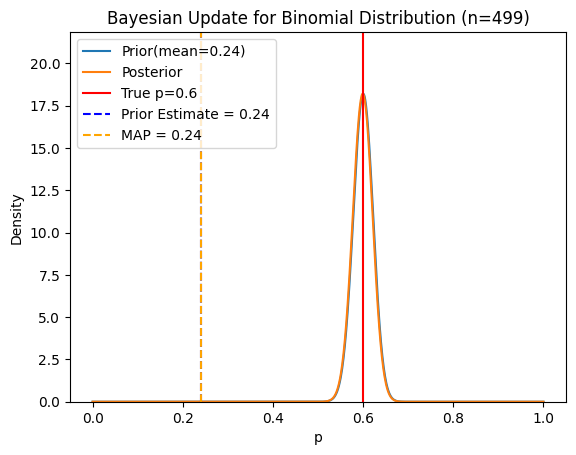

In [241]:
n_trials = 500
prior_estimate = prior_success_1/(prior_success_1+prior_failure_1)
posterior_estimate = prior_estimate

fig, ax = plt.subplots()
x = np.linspace(0,1,1000)

prior_beta = (beta_dist.pdf(x, prior_success_1, prior_failure_1))

#prior and post dists
prior_line, = ax.plot(x, prior_beta, label = f"Prior")
posterior_line, = ax.plot(x, prior_beta, label = f"Posterior (mean = {posterior_estimate:.2f})")

true_p_line = ax.axvline(true_p, color = 'r', label = f"True p={true_p}")
prior_estimate_line = ax.axvline(prior_estimate, color = 'b', linestyle= "--", label = f"Prior={prior_estimate}")
posterior_estimate_line = ax.axvline(posterior_estimate, color = 'orange', linestyle = '--', label = f"MAP ={posterior_estimate:.2f}")
ax.set_xlabel("p")
ax.set_ylabel("Density")
ax.set_title("Bayesian Update for Binomial Distribution")
ax.legend()


def update(frame):
  posterior_success = posterior_ss_1[frame]
  posterior_failure = posterior_fails_1[frame]
  posterior_estimate = maps[frame]

  #after getting the first posterior update the prior
  if frame != 0:
    prior_success = posterior_ss_1[frame-1]
    prior_failure = posterior_fails_1[frame-1]
    prior_estimate = maps[frame-1]

    #get prior distribution
    prior_beta = (beta_dist.pdf(x, prior_success, prior_failure))
    prior_line.set_ydata(prior_beta)
    prior_line.set_label(f'Prior(mean={prior_estimate:.2f})')

    #prior estimate
    prior_estimate_line.set_xdata([prior_estimate, prior_estimate])
    prior_estimate_line.set_label(f'Prior Estimate = {prior_estimate:.2f}')


  #for each frame, update the posterior dist

  #get posterior distribution
  posterior_beta = (beta_dist.pdf(x, posterior_success, posterior_failure))
  posterior_line.set_ydata(posterior_beta)
  posterior_line.set_label(f'Posterior')

  posterior_estimate_line.set_xdata([posterior_estimate, posterior_estimate])
  posterior_estimate_line.set_label(f'MAP = {posterior_estimate:.2f}')

  # Update y-axis limits
  ymax = np.max(posterior_beta) * 1.2  # Add 10% padding
  ax.set_ylim(0, ymax)

  ax.legend()
  ax.set_title(f"Bayesian Update for Binomial Distribution (n={frame})")

  return posterior_line, posterior_estimate_line, prior_line, prior_estimate_line

ani = animation.FuncAnimation(fig=fig, func=update, frames=n_trials, interval=50)
ani.save("binomial.mp4")
ani_html = ani.to_jshtml()
HTML(ani_html)

## Movie for Gaussian Dist with known σ²: prior μ=2, prior σ²=5

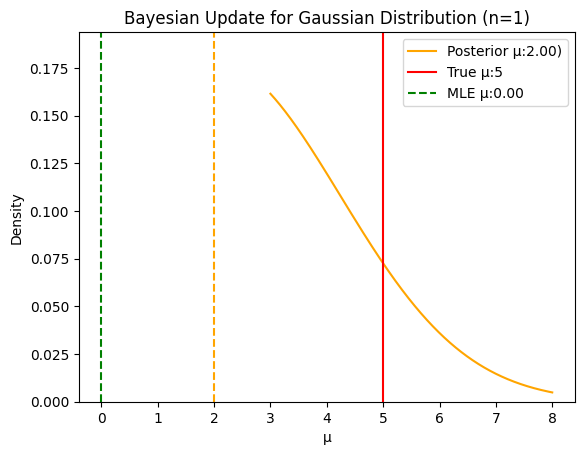

In [248]:
n_trials = len(mles_gauss_3)-1
prior_mean = 2
prior_var = 5

fig, ax = plt.subplots()
x = np.linspace((true_mean-true_std),(true_mean+true_std)+1,5000)

#plot all distributions
prior_gaussian = plot_gaussian(x, prior_mean_3, true_std)
posterior_gaussian_dist, = ax.plot(x, prior_gaussian, color = 'orange', label = f"Posterior (μ = {prior_mean_3:.2f})")


true_mean_line = ax.axvline(true_mean, color = 'r', label = f"True μ:{true_mean}")
posterior_gaussian_line = ax.axvline(prior_mean_3, color = 'orange', linestyle= "--")
mle_line = ax.axvline(0, color = 'g', linestyle="--", label = "MLE μ:0")
ax.set_xlabel("μ")
ax.set_ylabel("Density")
ax.set_title("Bayesian Update for Gaussian Distribution")
ax.legend()

def update(frame):
  posterior_mean = post_means_3[frame]
  posterior_var = post_vars_3[frame]


  #for each frame, update the posterior dist
  posterior_gaussian = plot_gaussian(x, posterior_mean, np.sqrt(posterior_var))
  posterior_gaussian_dist.set_ydata(posterior_gaussian)
  posterior_gaussian_dist.set_label(f'Posterior μ:{posterior_mean:.2f})')

  posterior_gaussian_line.set_xdata([posterior_mean, posterior_mean])
  mle_line.set_xdata([mles_gauss_3[frame], mles_gauss_3[frame]])
  mle_line.set_label(f"MLE μ:{mles_gauss_3[frame]:.2f}")

  # Update y-axis limits
  ymax = np.max(posterior_gaussian) * 1.2  # Add 10% padding
  ax.set_ylim(0, ymax)

  ax.legend()
  ax.set_title(f"Bayesian Update for Gaussian Distribution (n={frame+1})")

  return posterior_gaussian_dist, posterior_gaussian_line, mle_line

ani = animation.FuncAnimation(fig=fig, func=update, frames=n_trials, interval=50)
ani.save("gauss_known_var.mp4")
ani_html = ani.to_jshtml()
HTML(ani_html)

## Movie for Gamma Dist with known μ: prior a=3, prior b=2

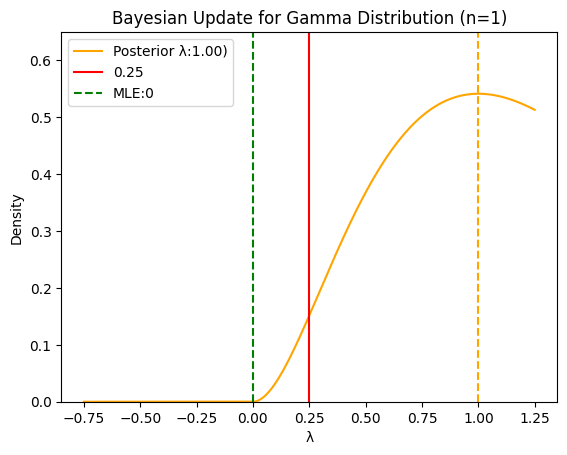

In [240]:
n_trials=len(post_as_3)-1
fig, ax = plt.subplots()
x = np.linspace(true_pres-1,true_pres+1,10000)

#plot all distributions
prior_gamma = stats.gamma.pdf(x, a=post_as_3[0], loc = 0, scale = 1/post_bs_3[0])
posterior_gamma_dist, = ax.plot(x, prior_gamma, color = 'orange', label = f"Posterior λ:{maps_gamma_3[0]:.2f})")

true_pres_line = ax.axvline(true_pres, color = 'r', label = f"{true_pres}")
# prior_gaussian_line = ax.axvline(prior_mean_3, color = 'b', linestyle= "--")
posterior_gamma_line = ax.axvline(maps_gamma_3[0], color = 'orange', linestyle= "--")
mle_line = ax.axvline(0, color = 'g', linestyle="--", label = "MLE:0")
ax.set_xlabel("λ")
ax.set_ylabel("Density")
ax.set_title("Bayesian Update for Gamma Distribution")
ax.legend()

def update(frame):
  posterior_a = post_as_3[frame]
  posterior_b = post_bs_3[frame]

  #for each frame, update the posterior dist
  posterior_gamma = stats.gamma.pdf(x, a=post_as_3[frame], loc = 0, scale = 1/post_bs_3[frame])
  posterior_gamma_dist.set_ydata(posterior_gamma)
  posterior_gamma_dist.set_label(f'Posterior λ:{maps_gamma_3[frame]:.2f})')

  posterior_gamma_line.set_xdata([maps_gamma_3[frame], maps_gamma_3[frame]])
  # print(mles_gamma_3[frame])
  mle_line.set_xdata([mles_gamma_3[frame], mles_gamma_3[frame]])

  # Update y-axis limits
  ymax = np.max(posterior_gamma) * 1.2  # Add 10% padding
  ax.set_ylim(0, ymax)

  ax.legend()
  ax.set_title(f"Bayesian Update for Gamma Distribution (n={frame+1})")

  return posterior_gamma_dist, posterior_gamma_line, mle_line

ani = animation.FuncAnimation(fig=fig, func=update, frames=n_trials, interval=100)
ani.save("gauss_known_mean.mp4")
ani_html = ani.to_jshtml()
HTML(ani_html)

# STRETCH GOAL 2 Gaussian Estimator unknown mean and var


In [244]:
# Posterior is normal-gamma or Gaussian-gamma dist Bishop 2.154
def normal_gamma_pdf(x_mean, x_lambda, a, b, mean_0, beta):
    # Normal part
    normal_part = plot_gaussian(x_mean, mean_0, 1/np.sqrt(beta * x_lambda))

    # Gamma part
    gamma_part = stats.gamma.pdf(x_lambda, a=a, loc=0, scale=1/b) #lambda_ is all possibles values of lambda x

    return normal_part * gamma_part

def bayesian_update(mean_0, beta, a, b, data):
    n = len(data)
    sample_mean = np.mean(data)

    # Update parameters
    # http://www2.stat.duke.edu/~rcs46/modern_bayes17/lecturesModernBayes17/lecture-4/04-normal-gamma.pdf
    beta_n = beta + n
    mean_n = ((beta * mean_0) + (n * sample_mean)) / beta_n
    a_n = a + n / 2
    b_n = b + 0.5 * np.sum((data - sample_mean)**2) + (beta * n * (sample_mean - mean_0)**2) / (2 * beta_n)

    return mean_n, beta_n, a_n, b_n


def plot_heatmap(mean, lambda_, pdf, title, true_mean, true_precision, ax):
    ax.contourf(mean, lambda_, pdf, levels=10)
    ax.plot(true_mean, true_precision, 'ro', markersize=3, label='True Values')
    ax.set_title(title)

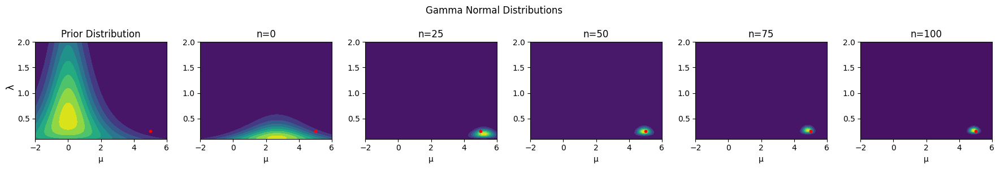

In [243]:
# Prior parameters
mean_0 = 0
beta = 1
a = 1
b = 1

#true params and sample data
true_mean = 5
true_std = 2
true_var = true_std**2 #this is known
true_pres = 1/true_var

# Generate data
n_trials = 100
#first create data from true gaussian dist
data = stats.norm.rvs(loc=true_mean, scale = np.sqrt(true_var), size=n_trials, random_state=seed)

# Create meshgrid
mean_range = np.linspace(-2, 6, 200)
lambda_range = np.linspace(0.1, 2, 200)
mean_mesh, lambda_mesh = np.meshgrid(mean_range, lambda_range)


# Perform Bayesian update
trial_numbers = np.arange(0, n_trials+1, (n_trials+1)//4)

#different shapes of the gamma dist with different values for a and b
fig, axes = plt.subplots(1, len(trial_numbers)+1, figsize = (3*(len(trial_numbers)+1), 3))
fig.suptitle(f"Gamma Normal Distributions")
fig.supylabel('λ')
for ax in axes.flat:
  ax.set(xlabel = 'μ')

# Calculate prior PDF
prior_pdf = normal_gamma_pdf(mean_mesh, lambda_mesh, a, b, mean_0, beta)
plot_heatmap(mean_mesh, lambda_mesh, prior_pdf, "Prior Distribution", true_mean, true_pres, axes[0])

for i,trial_number in enumerate(trial_numbers):
  observed_data = data[0:trial_number+1]
  mean_n, beta_n, a_n, b_n = bayesian_update(mean_0, beta, a, b, observed_data)

  # Calculate posterior PDF
  posterior_pdf = normal_gamma_pdf(mean_mesh, lambda_mesh, a_n, b_n, mean_n, beta_n)
  # Plot posterior heatmap
  plot_heatmap(mean_mesh, lambda_mesh, posterior_pdf, f"n={trial_number}", true_mean, true_pres,axes[i+1])

fig.tight_layout()
